# Predict Customer Churn

<img src="img/churn-rate.png" width="20%" height="20%">


Churn is the rate of employees who leave a company during a given period. It could affect the amount of revenue as a result of departures.  If you can control the churn rate it could be valuable to the organization.  Usually it is related to the response of services, customer satisfaction, pricing and competition for saying some aspects.

Let's put an example of churn.  If you are in an company and at the start of a time span it has 1000 clients, but at the end will have 650, then the churn is calculated by knowing the total churners (1000-650) and the customers at that timespan.  The churn rate in this case is 350/1000, that is 35%.

### What You will do?

You are a reknown data scientist and based on your skills you have been hired for the "Wonderfull Company Inc.".  Your first task is the concern of the leave of customers.

The CEO doesn't know why are leaving so he give you this first mission.  On the other hand, he wants to make you a Machine Learning algorithm to detect those churn people and make an action plan to mitigate the migration of valuable clients.

**Let's keep going and make you bright on this company.**

### Install some valuable libraries

First we will install and import some usefull libraries!!!!
- NOTE:  If you have to install it, enable it by clicking outside on the left of the box and press `y`

In [1]:
import pandas as pd                                         # data manipulation
import numpy as np                                          # array manipulation
import matplotlib.pyplot as plt                             # visualization tool
import seaborn as sns                                       # visualization tool
from pandas_profiling import ProfileReport                  # dataset profiling reporting tool
from sklearn.model_selection import train_test_split        # for divide our dataset in train and test datasets
from sklearn.preprocessing import OneHotEncoder             # one hot encode column transformer
from imblearn.under_sampling import RandomUnderSampler      # undersample data
from imblearn.over_sampling import SMOTE, RandomOverSampler # oversmple data
from sklearn.pipeline import make_pipeline                  # pipeline for efficient algorithm packing
from sklearn.preprocessing import StandardScaler            # scale the dataset
from sklearn.linear_model import SGDClassifier, RidgeClassifier # linear models
from sklearn.ensemble import RandomForestClassifier, GradientBoostingClassifier # boosting algorithms
from xgboost import XGBClassifier                           # xgboost algorithm
from sklearn.model_selection import GridSearchCV            # hyperparameter search
from sklearn.metrics import accuracy_score, recall_score    # import scikit-learn metrics
from sklearn.metrics import precision_score 
from sklearn.metrics import confusion_matrix, roc_auc_score
from sklearn.metrics import f1_score
import joblib                                               # for model serialization
import json                                                 # manipulation of json files
import os                                                   # use operating systems functions
%matplotlib inline                                          

C:\Users\Denys\AppData\Local\Temp\ipykernel_18728\845001400.py:5: DeprecationWarning: `import pandas_profiling` is going to be deprecated by April 1st. Please use `import ydata_profiling` instead.
  from pandas_profiling import ProfileReport                  # dataset profiling reporting tool


#### 1 - Import your Dataset

First things first, we need to import the dataset and have a look of what are we facing.

In [218]:
df = pd.read_csv('classificationdata.csv') # import our data
df_schema = df.copy()                      # make a copy (for schema later, do not put attention to this line by now)
df_schema.drop(['churn', 'id'], axis=1)            # drop churn (again, don't pay attention to this now)
df.head()                                  # see the first 5 rows

,id,state_code,tenure,contract_length,promotions_offered,remaining_term,last_nps_rating,area_code,international_plan,voice_mail_plan,...,total_eve_calls,total_eve_charge,total_night_minutes,total_night_calls,total_night_charge,total_intl_minutes,total_intl_calls,total_intl_charge,number_customer_service_calls,churn
0,0,HI,156,14.0,Yes,1.0,6.0,area_code_510,no,no,...,108,19.138302,208.349932,130,9.190181,8.015688,7,2.248902,7,no
1,1,MI,216,8.0,No,14.0,9.0,area_code_408,no,no,...,71,15.474436,228.902063,85,10.277852,9.683971,8,2.609739,3,no
2,2,NH,18,20.0,No,12.0,1.0,area_code_408,no,no,...,55,22.547297,202.353527,127,8.898488,14.039450,8,3.845776,2,no
3,3,MN,174,9.0,No,12.0,6.0,area_code_415,no,no,...,105,16.666506,214.487530,105,9.740333,13.031063,4,3.525823,1,no
4,4,TX,68,19.0,No,22.0,5.0,area_code_415,no,no,...,88,20.408969,190.047534,113,8.813303,6.760950,4,1.828652,0,no


We have plenty of colums like the contract_lenght, if he/she got promotions, the area code, number of calls received and other data.

We also have at the end if the customer have churned or not. More important we have some column that reflects the **nps** that is the customer satisfaction index.  If you did not localized it, find it just for know.

#### 2 - Basic Data Analysis

A very important part of the Data Scientist role is to do EDA (Exploratory Data Analysis).  We will first make some hypothesis of the data without looking at, and then start to explore the dataset, find insights that will be valuable later for present to our CEO or our team.

#### 2.1 - See some statistics

Statistics is our strong friend, lests look at the dataset basic info and later some statistics to gather some insights

- Finding the information of the dataset

In [3]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 17243 entries, 0 to 17242
Data columns (total 25 columns):
 #   Column                         Non-Null Count  Dtype  
---  ------                         --------------  -----  
 0   id                             17243 non-null  int64  
 1   state_code                     17243 non-null  object 
 2   tenure                         17243 non-null  int64  
 3   contract_length                17196 non-null  float64
 4   promotions_offered             17196 non-null  object 
 5   remaining_term                 17196 non-null  float64
 6   last_nps_rating                17196 non-null  float64
 7   area_code                      17231 non-null  object 
 8   international_plan             17243 non-null  object 
 9   voice_mail_plan                17213 non-null  object 
 10  number_vmail_messages          17243 non-null  int64  
 11  total_day_minutes              17243 non-null  float64
 12  total_day_calls                17243 non-null 

We have seen above that the dataset have 19 numeric columns and 6 categorical columns, mostly of the data is float and we also have some nulls (look, in example the churn column (24)).  We will deal with this later.

¿How many nans in each column?

Nans are like aliens, we did not see them but we know they exists, and if you find one, deal with them is very difficult.  First lets see how many of them are.

<img src="img/alien.jpg" width="30%" height="30%">

In [4]:
df.isna().sum()

id                                0
state_code                        0
tenure                            0
contract_length                  47
promotions_offered               47
remaining_term                   47
last_nps_rating                  47
area_code                        12
international_plan                0
voice_mail_plan                  30
number_vmail_messages             0
total_day_minutes                 0
total_day_calls                   0
total_day_charge                  0
total_eve_minutes                18
total_eve_calls                   0
total_eve_charge                  0
total_night_minutes               0
total_night_calls                 0
total_night_charge                0
total_intl_minutes                0
total_intl_calls                  0
total_intl_charge                 0
number_customer_service_calls     0
churn                            47
dtype: int64

For very first time, let's have a look of the view of the dataset by some basic metrics.

In [5]:
rows, cols = df.shape                # get the shape of the array
nans = df.isna().sum().sum()         # sums per axis=0 (rows) and then axis=1 (cols)
pcnt = str(round(nans/rows, 2)) + '%' # calculate percentage of nans in the full dataset
print(f'The Dataset has {rows} rows x {cols} cols, with a total of {nans} nans that represent a {pcnt} of the dataset')

The Dataset has 17243 rows x 25 cols, with a total of 295 nans that represent a 0.02% of the dataset


We have calculated above and see that nans doesn't represent a lot of data, but if you see carefully, the same amount of **`churn` nans** is probably the amount of **nans** in the rows `contract_lenght` `promotions_offered` `remaining_term`.

Now let's calculate some statistics.

In [6]:
df.describe()

,id,tenure,contract_length,remaining_term,last_nps_rating,number_vmail_messages,total_day_minutes,total_day_calls,total_day_charge,total_eve_minutes,total_eve_calls,total_eve_charge,total_night_minutes,total_night_calls,total_night_charge,total_intl_minutes,total_intl_calls,total_intl_charge,number_customer_service_calls
count,17243.000000,17243.000000,17196.000000,17196.000000,17196.000000,17243.000000,17243.000000,17243.000000,17243.000000,17225.000000,17243.000000,17243.000000,17243.000000,17243.000000,17243.000000,17243.000000,17243.000000,17243.000000,17243.000000
mean,8621.000000,100.317752,15.930449,11.142998,6.103745,8.621934,180.226434,100.136635,30.644015,200.438680,100.339442,17.029950,199.419909,99.883199,8.972442,10.303859,4.941715,2.775478,1.551006
std,4977.769681,39.802129,4.891274,7.223976,2.723776,13.033093,54.510880,20.060444,9.275700,50.693879,19.812595,4.308982,51.194689,20.381950,2.299784,2.784766,2.505491,0.744855,1.311701
min,0.000000,1.000000,8.000000,1.000000,1.000000,0.000000,0.005090,1.000000,0.027050,5.367495,1.000000,1.052621,3.896507,1.000000,0.472320,0.032252,0.000000,0.007152,0.000000
25%,4310.500000,73.000000,12.000000,5.000000,4.000000,1.000000,143.188201,87.000000,24.387270,167.015596,87.000000,14.168024,165.132904,86.000000,7.431499,8.532372,3.000000,2.300610,1.000000
50%,8621.000000,100.000000,16.000000,10.000000,7.000000,2.000000,180.129331,100.000000,30.596924,200.933145,101.000000,17.074940,198.518087,100.000000,8.940704,10.384425,5.000000,2.809832,1.000000
75%,12931.500000,127.000000,20.000000,18.000000,8.000000,16.000000,217.270262,113.000000,36.928498,234.301755,114.000000,19.911054,234.509463,114.000000,10.538214,12.080637,6.000000,3.259437,2.000000
max,17242.000000,242.000000,24.000000,24.000000,10.000000,52.000000,351.091823,165.000000,59.727092,357.739429,169.000000,30.515222,394.851052,173.000000,17.700351,19.981388,20.000000,5.398333,9.000000


Now we are talking about, if you have a look we can conclude some hypothesis from numbers.
- tenure is widely distributed (std_dev is higher compared to contract_length)
- most of the half of the measurements of the nps population (looking at [last_nps_rating](https://www.qualtrics.com/experience-management/customer/net-promoter-score/) 50% or above) is neutral.
- most number_vmal_messages is like skewed and wide (i recommend you look at this later on the graphs)

Now let's take a look for the categorical data because by default `describe` will only have a look by default of the numerical data.

In [7]:
df.describe(include=object)

,state_code,promotions_offered,area_code,international_plan,voice_mail_plan,churn
count,17243,17196,17231,17243,17213,17196
unique,51,3,3,2,2,2
top,WV,No,area_code_415,no,no,no
freq,560,15644,8549,15610,12722,14728


Interesting!. We saw that there was not promotions offered to customers.  Probably the other company will do promotions and that is why they are leaving... actually all the majority is for answer `no`, even with churn and that's good, but we can improve.  On the other hand we could have imbalance on the data, and we will discover it later.  Let's discover more insights in the distributions of the data!!!

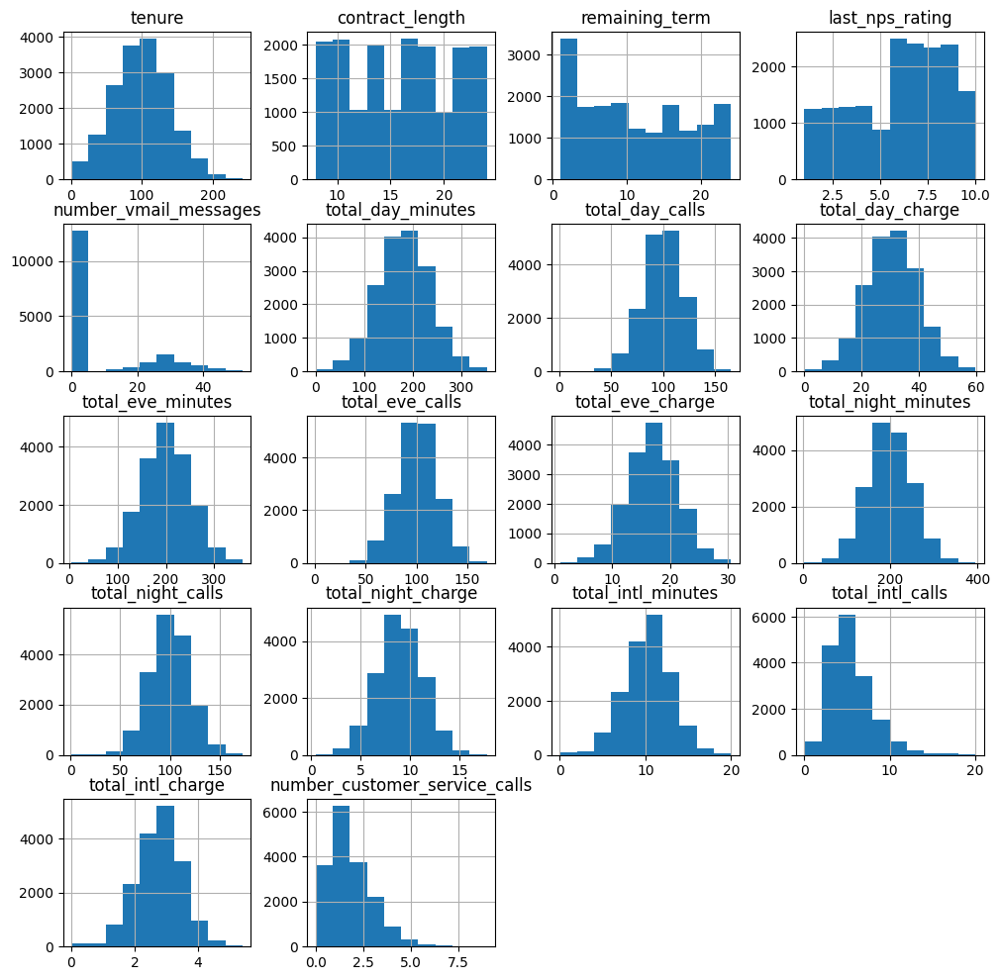

In [8]:
%matplotlib inline
df.drop('id', axis=1).hist(figsize=(12,12)) # we do not want id on the distribution plot
plt.show()                          # show the data

As we saw above the majority of the distributions follow a gaussian normal distribution, some like `number_customer_service_calls` or `total_intl_calls` are skewed. Others like `last_nps_rating` and `number_vmail_messages` are like following different distributions and partially concentrated on the left or right side saying us that the category is "polarized" to that section.

Let's concentrate analyzing `last_nps_rating`. As we say majority of the evaluations are in neutral (between 5-8) and like 1500 of the people are saying the service is good, but we have a considerable part of the popluation that evaluate the offered service below 5, that is like a considerable population (or slightly lower than the half of the graph).

#### 2.2 - Fast EDA with Pandas Profiling

Typically we will like to do in depth analysis but for us, right now let's use pandas-profiling to see the report

In [9]:
profile = ProfileReport(df, title='Profile Report of Customer Churn Dataset') # create the profile report
profile

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

Wow! Pandas Profiling do a great job analyzing the dataset. Let's have a look to the Alert Section.  As we read and go in depth on the dataset we will say that some variables has strong correlation.  Interestingly it says that

    `churn` is highly overall correlated with `remaining_term`
    
This is probably because that people with the less remaining the more will churn as the businesss.  As you investigate inside the pandas profile report you will se the distributions, correlations, missing and non missing rations, the mean and other statistics and more.  This is a very first analysis tool if you have a few columns.  It is not recommended to use pandas profiling if you have "big-data" because it will take some time and run out of memory.

Look at the distribution of `churn`.  This is an imbalance case, and is a regular day basis to encounter unbalanced datasets on the daily job, it is an more advanced topic than get a simple classification task but we will deal with unbalance dataset using a library callesd `imbalanced learn` (duhhh, ok i know this is so trivial).   In depth we will have some techniques like `undersample` and `oversample`.  

Undersample probably is a good option because we will cut some majority class to make it equal to the minority class, on the other hand, oversampler, makes synthetic samples using probabilities and makes the minority data to keep at the same quantity to equiparete the data.  Obviously we can oversample majority, minority or other things in the dataset but we are explaining just the basic idea of over or undersample.

Keep scrolling down and you will see clearly the matrix of correlations that will explain visually the correlations of the data.

#### 2.3 - Inspect the target class

If ourselves are doing the analysis the first thing to do is univariate analysis, that is looking the target class with each of the columns to get more insights of relationships and have some conclussions.

Let's have a look at first of the relationship of the target distributions.

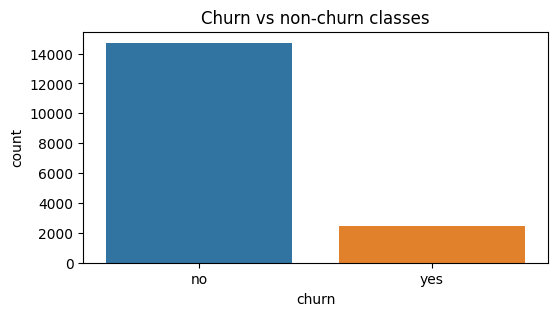

In [10]:
plt.figure(figsize=(6,3))
sns.countplot(data=df, x='churn')
plt.title('Churn vs non-churn classes')
plt.show()

You see!, there is a lot of people that will not churn, but we can do better, and as i said in this case is a case of imbalanced class dataset.

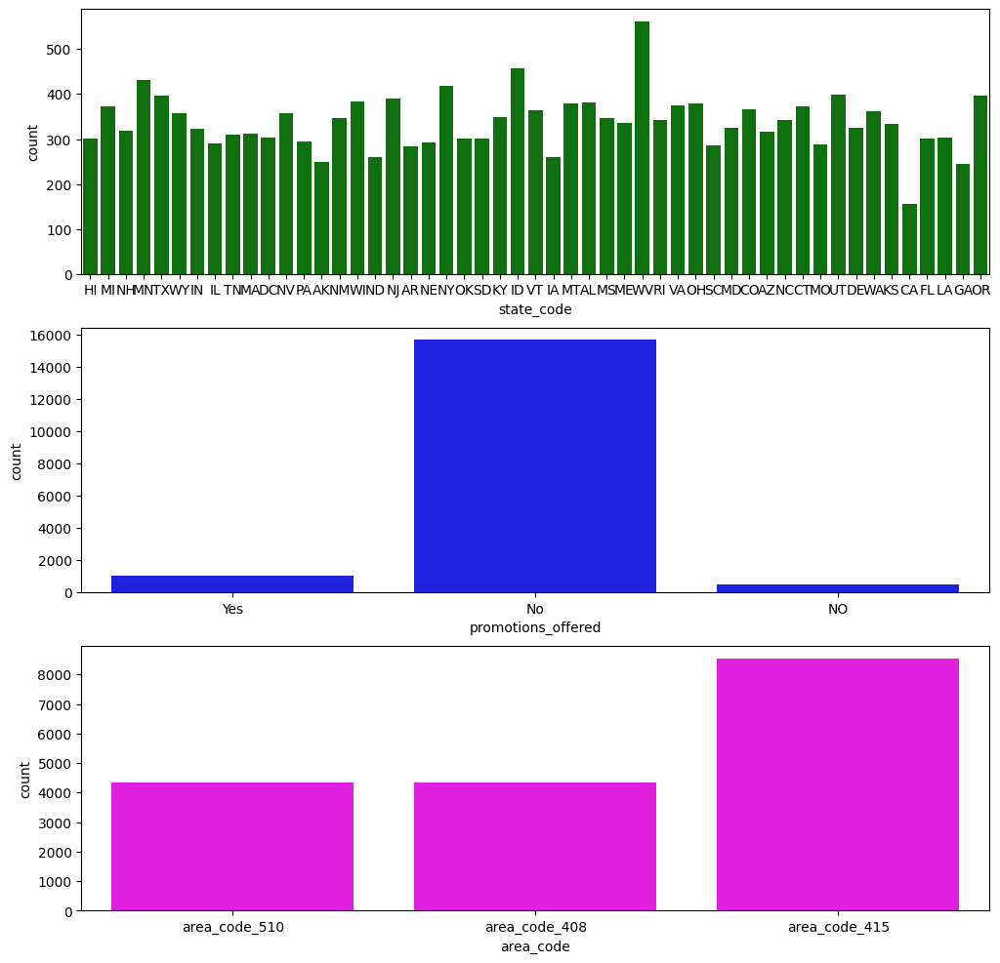

In [11]:
fig, ax = plt.subplots(3, figsize=(12, 12))                            # get the figure and ax properties
sns.countplot(data=df, x='state_code', ax=ax[0], color='green')        # plot the first graph
sns.countplot(data=df, x='promotions_offered', ax=ax[1], color='blue') # plot the second graph
sns.countplot(data=df, x='area_code', ax=ax[2], color='magenta') # plot the second graph
plt.show()

Now we see the importance of visualization, we can get insights of the dataset, let's focus on promotion, did you note something odd, yes, `NO` and `No` probably means the same so we will fix it and replace it.  

On the other hand if we see the area code we can say that the frequency of total population is concentrated at 1/2 on the area code 415.  

Matplotlib and seaborn can facilitate your life of reporting and we can save the figure.

In [12]:
fig.savefig('analysis.png')

#### 2.4 - Inspect the customer  service calls and vmail messages

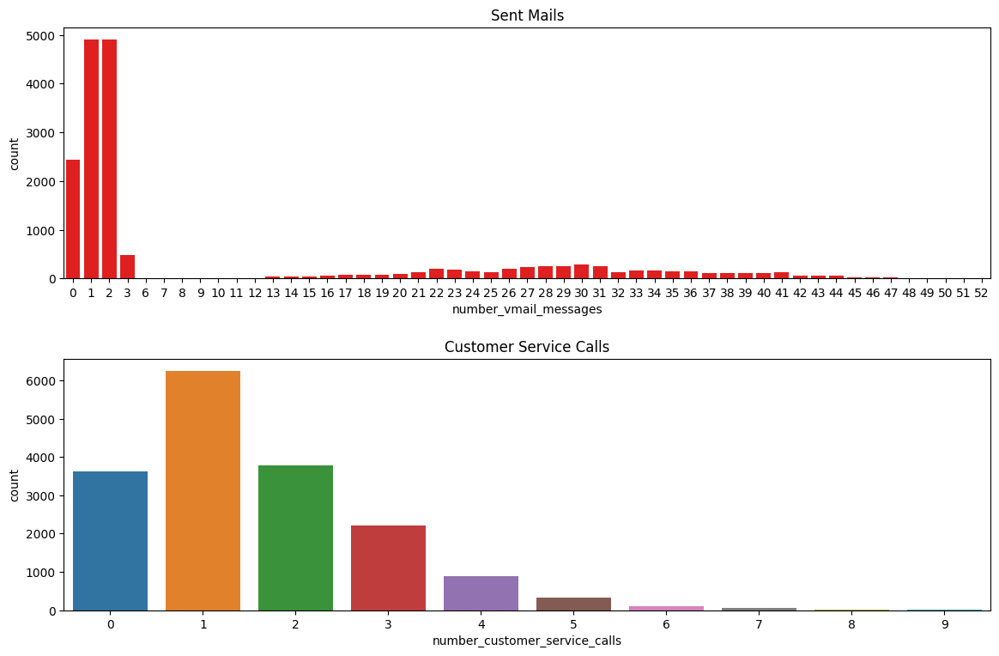

In [13]:
fig, ax = plt.subplots(2, figsize=(12, 8))                               # size of the figure
sns.countplot(data=df, x='number_vmail_messages', ax=ax[0], color='red') # number os set mail messages
sns.countplot(data=df, x='number_customer_service_calls', ax=ax[1])      # customer calls qty distribution
ax[0].set_title('Sent Mails')
ax[1].set_title('Customer Service Calls')
fig.tight_layout(pad=2.0)
plt.show()

As we saw above the data is skewed, if we have a long tail over the right, we say is positively skewed, and if the tail os over the left we say is negatively skewed.  Let's measure it to conclude the skewness.

In [14]:
print(f'Vmail Messages skewness = {df.number_vmail_messages.skew():.3f}') 
print(f'Customer Service Calls skewness = {df.number_customer_service_calls.skew():.3f}')

Vmail Messages skewness = 1.387
Customer Service Calls skewness = 1.083


I could tell you something, we can modify the data to partially emulate normal distribution, why we need it in that form?, well, ML models work better if the dataset is normally distributed, because the theory is in that way developed, so we will receive well data normally distributed as our desired guest.

Let's try to fix one column, let's say the previous `number_customer_service_calls`.

In [15]:
df['log_number_customer_service_calls'] = np.log1p(df.number_customer_service_calls)
print(f'Log number_customer_service_calls {df.log_number_customer_service_calls.skew()}')

Log number_customer_service_calls -0.12239922967539515


As we see above, if we compare the skewness with and without transformation is better to transform to remove the skewness, but let's have a look of this data skewness.

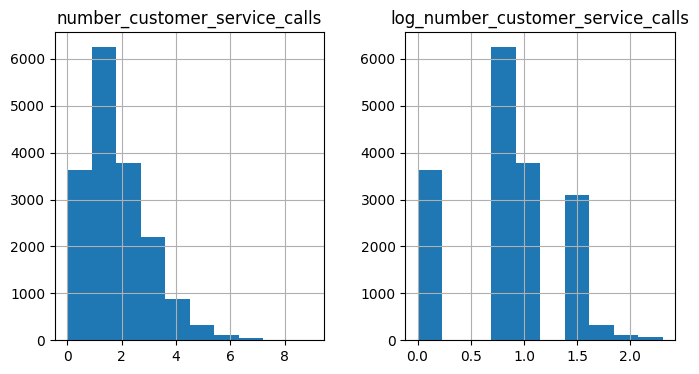

In [16]:
df[['number_customer_service_calls', 'log_number_customer_service_calls']].hist(figsize=(8, 4))
plt.show()

Now we are talking about.  If you se the data is actually better distributed and emulate a normal distribution.

#### 2.5 - Look into Numeric-Numeric Correlation

We are interested not only on the distribution of each variable alone but to compare numerically together the variables.

Let's do some basic correlation using a heatmap.  

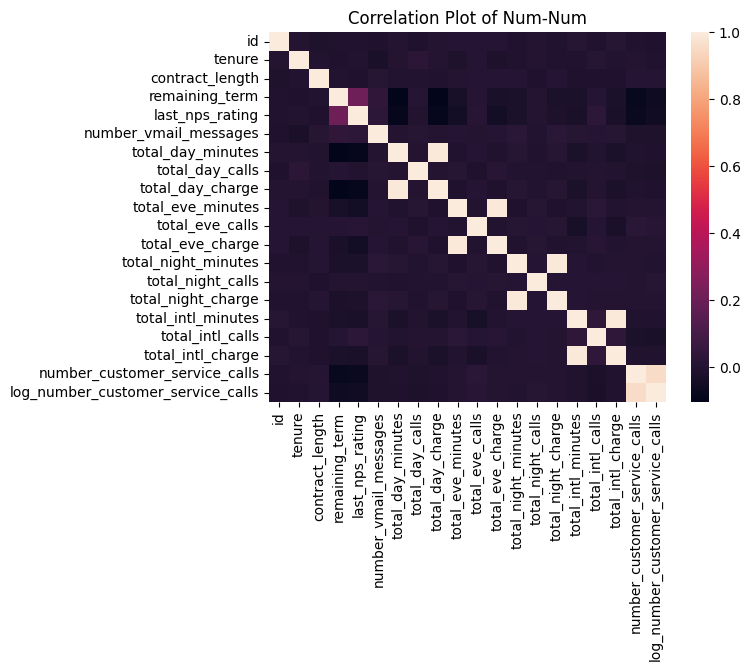

In [17]:
numeric_only_df = df.select_dtypes(include=np.number)
sns.heatmap(data=numeric_only_df.corr(), annot=False, cbar=True)
plt.title('Correlation Plot of Num-Num')
plt.show()

Above we can see interesting things, that for example, the `total_intl_charge` is related to `total_intl_minutes`. You got it? Areas more brighter in this case are highly correlated and areas that are opaque are not correlated at all.  For example it says, the longer intl charge is the longer international minutes is the call.  On the other hand the less the nps is the higher the remaining term.

This only represents linear correlation, but we can encounter (not with corr, but in the ML model) non-linear relationships variables that are not evident via simple statistics.

Let's analyze churn, it could be a numeric variable if we transform the label.

In [18]:
df.churn.unique()

array(['no', 'yes', nan], dtype=object)

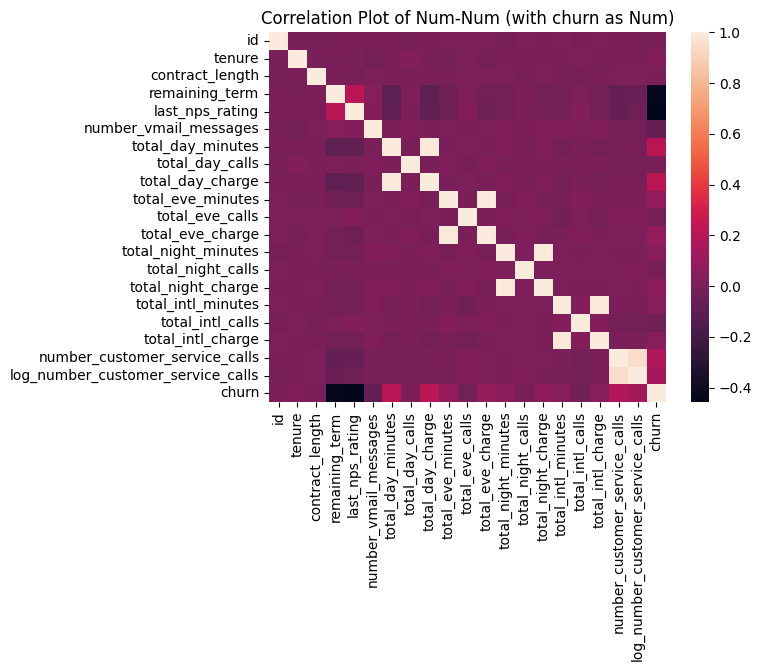

In [19]:
numeric_only_df['churn'] = np.where(df.churn=='yes', 1, 0)
sns.heatmap(data=numeric_only_df.corr(), annot=False, cbar=True)
plt.title('Correlation Plot of Num-Num (with churn as Num)')
plt.show()

Now we can se clearly the churn target variable with the other numerical variables.  Interestingly we saw that the higher the churn value (because is white) the less the last_nps_rating (because is dark).  

That says so much about the churn and the client satisfaction and the churn rate, it's probably if the people get dissatisfied will eventually will churn.

The higger the customer service calls the higher rate the customer will churn.

#### 2.6 - Plot Churn vs numerical

Another visualization is to check the distribution of the numerical data in the churn rate over each numerical data. Let's do it.

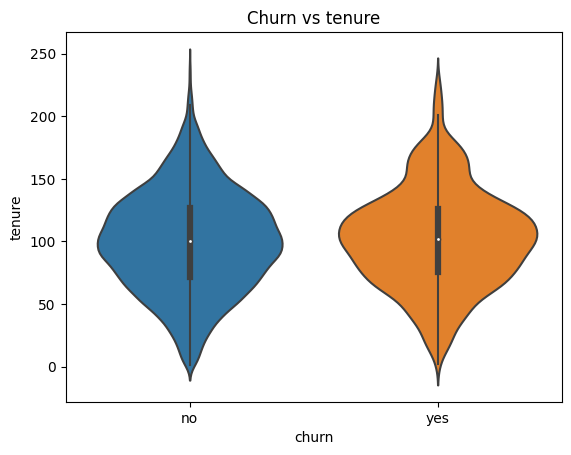

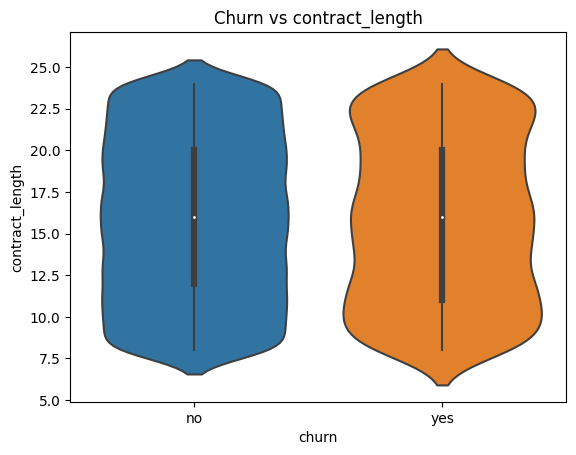

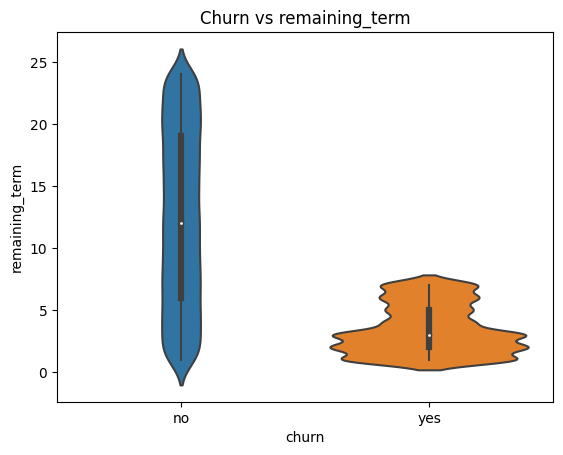

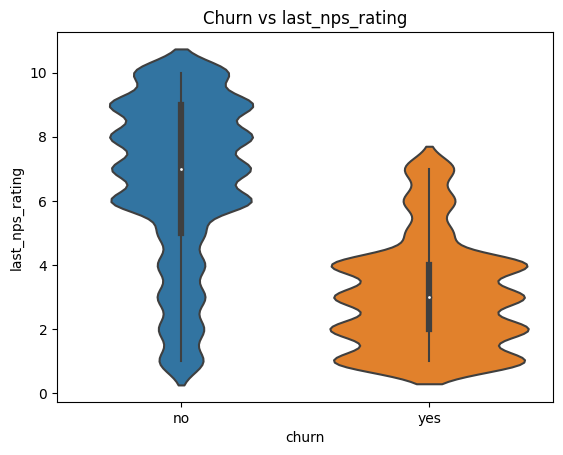

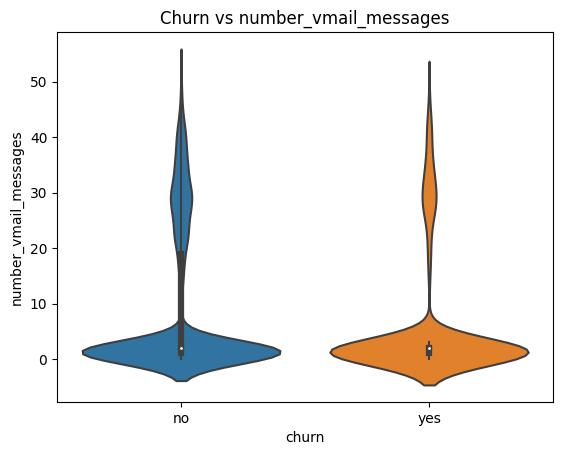

...

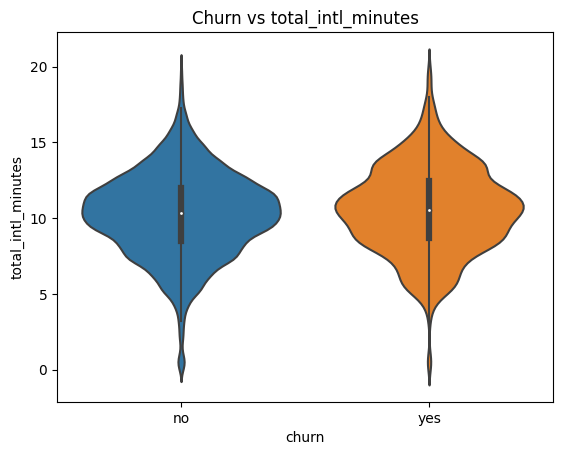

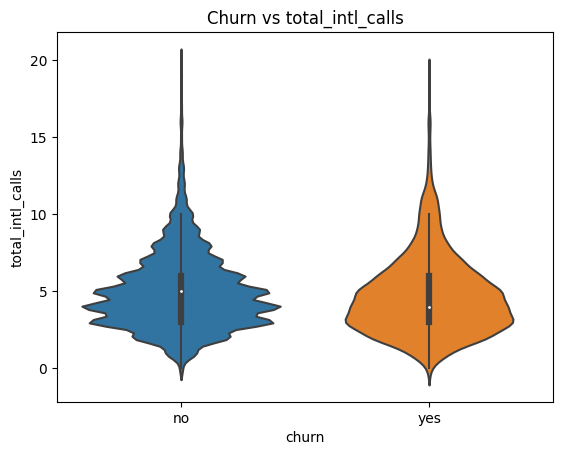

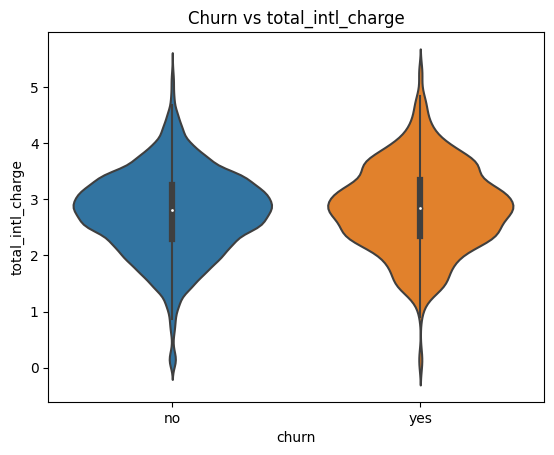

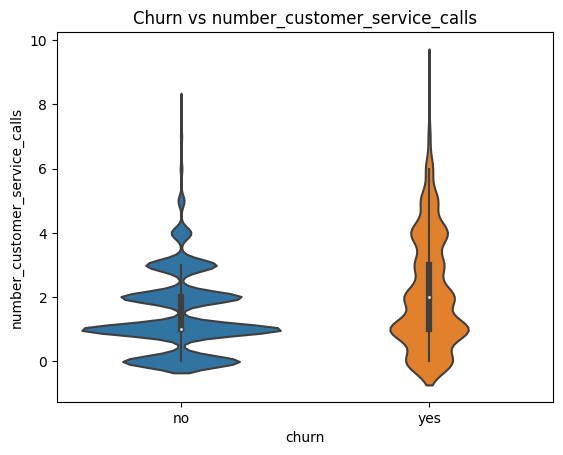

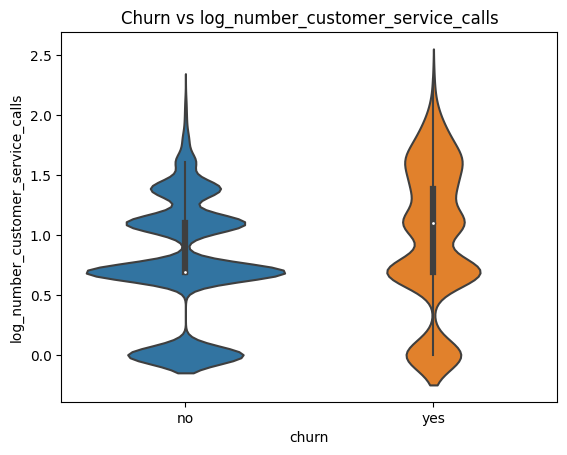

In [20]:
for col in df.drop('id', axis=1).select_dtypes(include=np.number).columns:  # loop over the numerical data
    sns.violinplot(data=df, x='churn', y=col)            # plot violin each column
    plt.title(f'Churn vs {col}')                         # set the tile
    plt.show()                                           # show the plot

As we probably saw, for plotting churn vs numeric data is very interesting. Again if we analyze `churn` vs `remaining_term` we can conclude again that people that have less remaining term (now seen that like 7 or less) will probably churn. 

`number_service_calls` says that people that will churn will receive mor calll, if we look at the median of the data we can see is above the median of the non-churners.

Let's add another visualization for the last variables, that is called a bivariate analysis.

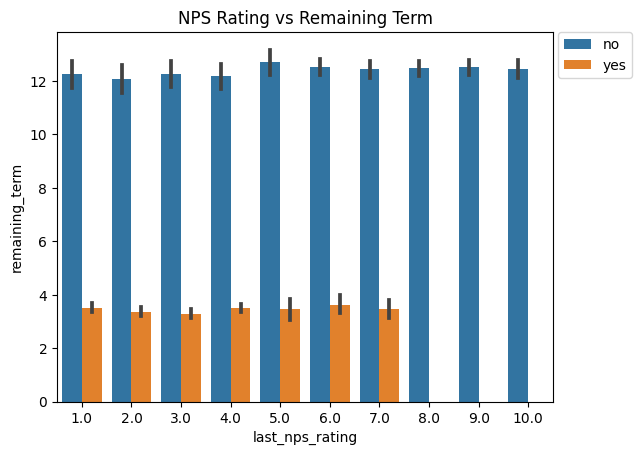

In [21]:
sns.barplot(data=df, x='last_nps_rating', y='remaining_term', hue='churn')
plt.legend(bbox_to_anchor=(1.01, 1), loc='upper left', borderaxespad=0)
plt.title('NPS Rating vs Remaining Term')
plt.show()

We can conclude that when the nps is less than 7 and people remaining term is less than 4 probably will churn.

#### 2.7 - Plot Categorical Relationship to Churn

As you remember we have some missing values here in the `promotions_offered` column and another mistake to clean, NO and No.

In [22]:
df.promotions_offered.unique() # get the unique values

array(['Yes', 'No', 'NO', nan], dtype=object)

In [23]:
df_ = df.copy() # make a copy of the array to not alter the original dataset
df_.promotions_offered = df_.promotions_offered.replace(to_replace=['NO', np.nan], value='No') # replace NO and nan by No

In [24]:
pd.crosstab(index=df_['promotions_offered'], columns=df_['churn'], normalize=True)*100 # compute pivot table of frequencies

churn,no,yes
promotions_offered,,
No,82.426146,11.578274
Yes,3.221679,2.773901


Clearly we can see that people that have more churns (11%) has not offered promotions.

In [25]:
for col in df.select_dtypes(include='object').columns:
    display(pd.crosstab(index=df_[col], columns=df_['churn'], normalize=True)*100) # compute pivot table of frequencies

churn,no,yes
state_code,,
AK,1.325890,0.122121
AL,1.913236,0.279135
AR,1.424750,0.220982
AZ,1.639916,0.168644
CA,0.726913,0.180274
CO,1.895790,0.220982
CT,1.802745,0.360549
DC,1.477088,0.238428
DE,1.546871,0.331472


churn,no,yes
promotions_offered,,
No,82.426146,11.578274
Yes,3.221679,2.773901


churn,no,yes
area_code,,
area_code_408,21.659683,3.590549
area_code_415,42.655959,6.925047
area_code_510,21.322160,3.846601


churn,no,yes
international_plan,,
no,79.762736,10.740870
yes,5.885090,3.611305


churn,no,yes
voice_mail_plan,,
no,61.930560,12.070372
yes,23.738786,2.260282


churn,no,yes
churn,,
no,85.647825,0.000000
yes,0.000000,14.352175


#### 2.8 - Relationship between Remaining Term and NPS Rating? Are there promotions offered?

Remember previously that we saw that people of less than 7 of rating and less than 5 in term will churn?, Let's see if there is more relationships.

In [26]:
df_['nps_less_7'] = (df_.last_nps_rating <= 7).astype(int)
df_['remaining_term_less_5'] = (df_.remaining_term < 5).astype(int)
df_['churn_y'] = (df_.churn == 'yes').astype(int)
df_['churn_n'] = (df_.churn == 'no').astype(int)

In [27]:
df_.groupby(['nps_less_7', 'remaining_term_less_5']).sum(['churn_y', 'churn_n'])[['churn_y', 'churn_n']]/len(df_)

churn_y   churn_n
nps_less_7 remaining_term_less_5                    
0          0                      0.000000  0.303659
           1                      0.000000  0.061184
1          0                      0.043322  0.403932
           1                      0.099809  0.085368

We can see that the Churn rate is from 10%

In [28]:
df_.groupby(['nps_less_7', 'remaining_term_less_5', 'promotions_offered']).sum(['churn_y', 'churn_n'])[['churn_y', 'churn_n']]/len(df_)

churn_y   churn_n
nps_less_7 remaining_term_less_5 promotions_offered                    
0          0                     No                  0.000000  0.303659
           1                     No                  0.000000  0.061184
1          0                     No                  0.035087  0.403932
                                 Yes                 0.008235  0.000000
           1                     No                  0.080380  0.053239
                                 Yes                 0.019428  0.032129

Note in the table above that for nps above 7 people are not churning, but no matter what you will do if the nps is below 7 people start to churn. 

Also the churn rate is from 8% and they do not get promotions.

#### 3 - Prepare the dataset for be ready for Machine Learning

Missing Values sometimes are a problem in machine learning, let's have a look again at the nulls.

In [29]:
df.isna().sum()

id                                    0
state_code                            0
tenure                                0
contract_length                      47
promotions_offered                   47
remaining_term                       47
last_nps_rating                      47
area_code                            12
international_plan                    0
voice_mail_plan                      30
number_vmail_messages                 0
total_day_minutes                     0
total_day_calls                       0
total_day_charge                      0
total_eve_minutes                    18
total_eve_calls                       0
total_eve_charge                      0
total_night_minutes                   0
total_night_calls                     0
total_night_charge                    0
total_intl_minutes                    0
total_intl_calls                      0
total_intl_charge                     0
number_customer_service_calls         0
churn                                47


Let's start with area code, and check the rows that are missing

In [30]:
df[df.area_code.isna()].head()

,id,state_code,tenure,contract_length,promotions_offered,remaining_term,last_nps_rating,area_code,international_plan,voice_mail_plan,...,total_eve_charge,total_night_minutes,total_night_calls,total_night_charge,total_intl_minutes,total_intl_calls,total_intl_charge,number_customer_service_calls,churn,log_number_customer_service_calls
1045,1045,FL,154,20.0,No,8.0,4.0,NaN,yes,no,...,12.660728,195.951478,137,8.485496,8.104295,4,2.375303,0,no,0.0
1642,1642,MO,154,15.0,No,2.0,7.0,NaN,yes,no,...,8.753738,198.839157,94,9.278937,7.073209,6,1.943637,0,no,0.0
4558,4558,WY,58,22.0,No,20.0,6.0,NaN,no,NaN,...,15.370818,185.992442,115,8.634951,9.258257,4,2.522559,0,no,0.0
5772,5772,MO,155,12.0,No,3.0,9.0,NaN,yes,no,...,8.018185,200.103367,96,9.318969,7.688405,7,1.940647,0,no,0.0
8668,8668,MO,149,10.0,No,21.0,1.0,NaN,yes,no,...,8.366050,204.967213,92,9.761769,7.618982,7,2.056359,0,no,0.0


So we see above that the area code has missing values, one thing that we could do is remove that values, but probably those values or the other data is important, so better is to impute those values instead of remove it, if there are only one or two missing probably is ok to remove from the dataset but in this case are not.

In [31]:
df.area_code.fillna('missing', inplace=True)
df[df.area_code=='missing'].head()

,id,state_code,tenure,contract_length,promotions_offered,remaining_term,last_nps_rating,area_code,international_plan,voice_mail_plan,...,total_eve_charge,total_night_minutes,total_night_calls,total_night_charge,total_intl_minutes,total_intl_calls,total_intl_charge,number_customer_service_calls,churn,log_number_customer_service_calls
1045,1045,FL,154,20.0,No,8.0,4.0,missing,yes,no,...,12.660728,195.951478,137,8.485496,8.104295,4,2.375303,0,no,0.0
1642,1642,MO,154,15.0,No,2.0,7.0,missing,yes,no,...,8.753738,198.839157,94,9.278937,7.073209,6,1.943637,0,no,0.0
4558,4558,WY,58,22.0,No,20.0,6.0,missing,no,NaN,...,15.370818,185.992442,115,8.634951,9.258257,4,2.522559,0,no,0.0
5772,5772,MO,155,12.0,No,3.0,9.0,missing,yes,no,...,8.018185,200.103367,96,9.318969,7.688405,7,1.940647,0,no,0.0
8668,8668,MO,149,10.0,No,21.0,1.0,missing,yes,no,...,8.366050,204.967213,92,9.761769,7.618982,7,2.056359,0,no,0.0


Good, as we see we have fill those values that are missing with some data and not to drop them. Let's repeat the same with voice mail plan

In [32]:
df.voice_mail_plan.fillna('missing', inplace=True)

Now lets continue with the total_eve_minutes

In [33]:
df[df.total_eve_minutes.isna()][['total_eve_minutes']]

,total_eve_minutes
1740,NaN
2642,NaN
2729,NaN
4543,NaN
4558,NaN
4908,NaN
9348,NaN
10016,NaN
10202,NaN
11193,NaN


Hmmm, to much data missing. So let's do something special.  Let's calculate the mean minutes and imput them on the nans, but also we will create a tag column to take them for the machine learning model that those are missing.

In [34]:
mean_eve_min = np.round(df.total_eve_minutes.mean(),4)  # calculate the mean
mean_eve_min

200.4387

In [35]:
np.round(df.total_day_charge.std(), 4) # calculate the stddev

9.2757

We saw above the calculations that will be replaced later, we also view that the stddev of total_day_charge is not so variant, we can do several fancy imputations, but with this example we will keep it simple.

In [36]:
df['total_eve_minutes_missing'] = df.total_eve_minutes.isna().astype(bool) # tag the null values as False in a new column
df.total_eve_minutes.fillna(mean_eve_min, inplace=True) # replace by the mean in the nulls/nans

Now lets move with the churn and see which are the missing values

In [37]:
df.isna().sum()

id                                    0
state_code                            0
tenure                                0
contract_length                      47
promotions_offered                   47
remaining_term                       47
last_nps_rating                      47
area_code                             0
international_plan                    0
voice_mail_plan                       0
number_vmail_messages                 0
total_day_minutes                     0
total_day_calls                       0
total_day_charge                      0
total_eve_minutes                     0
total_eve_calls                       0
total_eve_charge                      0
total_night_minutes                   0
total_night_calls                     0
total_night_charge                    0
total_intl_minutes                    0
total_intl_calls                      0
total_intl_charge                     0
number_customer_service_calls         0
churn                                47


The posibility to be churn the same rows that contract_length, promotions_offered, remaining_term and last_nps_rating be the same null is high, we will drop them by now just to continue fast.

In [38]:
df = df[~df.last_nps_rating.isna()]   # we select all that are not nans and replace the dataframe
df

,id,state_code,tenure,contract_length,promotions_offered,remaining_term,last_nps_rating,area_code,international_plan,voice_mail_plan,...,total_night_minutes,total_night_calls,total_night_charge,total_intl_minutes,total_intl_calls,total_intl_charge,number_customer_service_calls,churn,log_number_customer_service_calls,total_eve_minutes_missing
0,0,HI,156,14.0,Yes,1.0,6.0,area_code_510,no,no,...,208.349932,130,9.190181,8.015688,7,2.248902,7,no,2.079442,False
1,1,MI,216,8.0,No,14.0,9.0,area_code_408,no,no,...,228.902063,85,10.277852,9.683971,8,2.609739,3,no,1.386294,False
2,2,NH,18,20.0,No,12.0,1.0,area_code_408,no,no,...,202.353527,127,8.898488,14.039450,8,3.845776,2,no,1.098612,False
3,3,MN,174,9.0,No,12.0,6.0,area_code_415,no,no,...,214.487530,105,9.740333,13.031063,4,3.525823,1,no,0.693147,False
4,4,TX,68,19.0,No,22.0,5.0,area_code_415,no,no,...,190.047534,113,8.813303,6.760950,4,1.828652,0,no,0.000000,False
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
17238,17238,NY,142,14.0,No,1.0,1.0,area_code_415,yes,no,...,62.263008,89,2.872740,0.493638,0,0.250048,3,yes,1.386294,False
17239,17239,ID,93,8.0,No,9.0,7.0,area_code_415,yes,yes,...,224.625284,95,10.627770,12.870274,6,3.370551,1,no,0.693147,False
17240,17240,TX,110,24.0,No,3.0,7.0,area_code_510,no,no,...,146.474026,59,6.367553,14.037650,5,4.001911,4,no,1.609438,False
17241,17241,TN,8,10.0,No,3.0,10.0,area_code_415,no,no,...,214.348043,88,9.179660,7.373555,2,1.921722,1,no,0.693147,False


In [39]:
df.isna().sum()

id                                   0
state_code                           0
tenure                               0
contract_length                      0
promotions_offered                   0
remaining_term                       0
last_nps_rating                      0
area_code                            0
international_plan                   0
voice_mail_plan                      0
number_vmail_messages                0
total_day_minutes                    0
total_day_calls                      0
total_day_charge                     0
total_eve_minutes                    0
total_eve_calls                      0
total_eve_charge                     0
total_night_minutes                  0
total_night_calls                    0
total_night_charge                   0
total_intl_minutes                   0
total_intl_calls                     0
total_intl_charge                    0
number_customer_service_calls        0
churn                                0
log_number_customer_servi

Excellent!, we got some dataset cleaning and we are ready to continue for making feature engineering before feeding our machine learning model.

But first, let's reset our index just to keep clean.

In [40]:
df.reset_index(inplace=True, drop=True) # reset the index and drop that index
df.set_index('id', inplace=True)        # set the id to the index

In [41]:
df.head()

,state_code,tenure,contract_length,promotions_offered,remaining_term,last_nps_rating,area_code,international_plan,voice_mail_plan,number_vmail_messages,...,total_night_minutes,total_night_calls,total_night_charge,total_intl_minutes,total_intl_calls,total_intl_charge,number_customer_service_calls,churn,log_number_customer_service_calls,total_eve_minutes_missing
id,,,,,,,,,,,,,,,,,,,,,
0,HI,156,14.0,Yes,1.0,6.0,area_code_510,no,no,0,...,208.349932,130,9.190181,8.015688,7,2.248902,7,no,2.079442,False
1,MI,216,8.0,No,14.0,9.0,area_code_408,no,no,3,...,228.902063,85,10.277852,9.683971,8,2.609739,3,no,1.386294,False
2,NH,18,20.0,No,12.0,1.0,area_code_408,no,no,1,...,202.353527,127,8.898488,14.039450,8,3.845776,2,no,1.098612,False
3,MN,174,9.0,No,12.0,6.0,area_code_415,no,no,2,...,214.487530,105,9.740333,13.031063,4,3.525823,1,no,0.693147,False
4,TX,68,19.0,No,22.0,5.0,area_code_415,no,no,1,...,190.047534,113,8.813303,6.760950,4,1.828652,0,no,0.000000,False


#### 4 - Feature Engineering in the dataset

Next is a part necessary for our machine learning algorithms, feature engineering.

With feature engineering we can aid the model to predict efficiently the classes. Remember that we noted this class of problem is imbalanced meaning that one target variable is far away more populated than the other.

Let's again build the heatmap to see correlations.

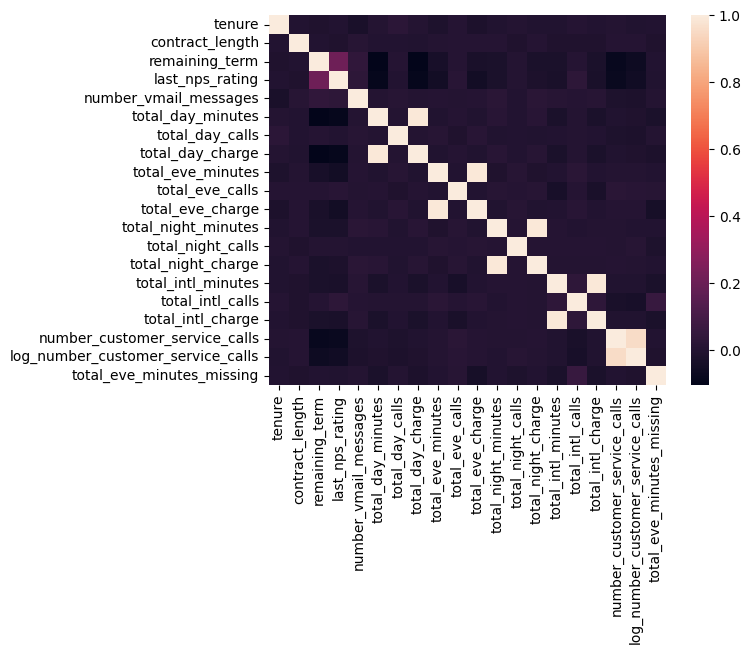

In [42]:
sns.heatmap(data=df.select_dtypes(exclude='object').corr())
plt.show()

Again, we see that the related features are based on timing, that makes sense because the more the charge the churn rate probably will increase.  Let's make fun and make some features.

In [43]:
df['day_ratio'] = df['total_day_charge'] / df['total_day_minutes']
df['eve_ratio'] = df['total_eve_charge'] / df['total_eve_minutes']
df['night_ratio'] = df['total_night_charge'] / df['total_night_minutes']
df['intl_ratio'] = df['total_intl_charge'] / df['total_intl_minutes']

C:\Users\Denys\AppData\Local\Temp\ipykernel_18728\1556721096.py:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['day_ratio'] = df['total_day_charge'] / df['total_day_minutes']
C:\Users\Denys\AppData\Local\Temp\ipykernel_18728\1556721096.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['eve_ratio'] = df['total_eve_charge'] / df['total_eve_minutes']
C:\Users\Denys\AppData\Local\Temp\ipykernel_18728\1556721096.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a Data

In [44]:
df.head()

,state_code,tenure,contract_length,promotions_offered,remaining_term,last_nps_rating,area_code,international_plan,voice_mail_plan,number_vmail_messages,...,total_intl_calls,total_intl_charge,number_customer_service_calls,churn,log_number_customer_service_calls,total_eve_minutes_missing,day_ratio,eve_ratio,night_ratio,intl_ratio
id,,,,,,,,,,,,,,,,,,,,,
0,HI,156,14.0,Yes,1.0,6.0,area_code_510,no,no,0,...,7,2.248902,7,no,2.079442,False,0.175435,0.082497,0.044109,0.280563
1,MI,216,8.0,No,14.0,9.0,area_code_408,no,no,3,...,8,2.609739,3,no,1.386294,False,0.171020,0.081115,0.044901,0.269491
2,NH,18,20.0,No,12.0,1.0,area_code_408,no,no,1,...,8,3.845776,2,no,1.098612,False,0.172615,0.084012,0.043975,0.273926
3,MN,174,9.0,No,12.0,6.0,area_code_415,no,no,2,...,4,3.525823,1,no,0.693147,False,0.155908,0.085223,0.045412,0.270571
4,TX,68,19.0,No,22.0,5.0,area_code_415,no,no,1,...,4,1.828652,0,no,0.000000,False,0.174446,0.085782,0.046374,0.270473


Alright, now let's drop the additional features because probably we will not need them anymore.

In [45]:
df.drop(columns=['total_day_charge', 'total_day_minutes', 'total_eve_charge',
         'total_eve_minutes', 'total_night_charge', 'total_night_minutes',
         'total_intl_charge', 'total_intl_minutes'], axis=1, inplace=True)

C:\Users\Denys\AppData\Local\Temp\ipykernel_18728\3960778192.py:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df.drop(columns=['total_day_charge', 'total_day_minutes', 'total_eve_charge',


Now take a look at the skewness of the dataset, let's have a look to the customer service calls first.
Remember that our machine learning model needs the feed of normal distributions if possible to improve the prediction.

In [46]:
df['number_customer_service_calls'] = np.log1p(df.number_customer_service_calls)

C:\Users\Denys\AppData\Local\Temp\ipykernel_18728\4225743302.py:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['number_customer_service_calls'] = np.log1p(df.number_customer_service_calls)


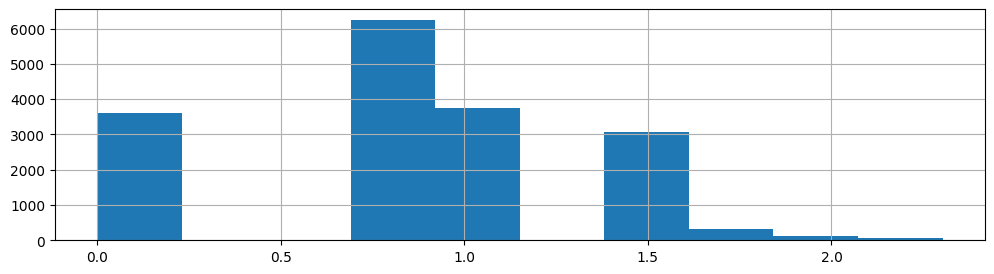

In [47]:
df['number_customer_service_calls'].hist(figsize=(12,3))
plt.show()

We noted previously that there was some missing customers and a bad written word NO and No that are equal, so let's try and get the transformation to promotions_offered.

In [48]:
df.promotions_offered.unique()

array(['Yes', 'No', 'NO'], dtype=object)

In [49]:
df['promotions_offered'] = df.promotions_offered.replace(to_replace=['NO', np.nan], value='No')

C:\Users\Denys\AppData\Local\Temp\ipykernel_18728\2821360893.py:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['promotions_offered'] = df.promotions_offered.replace(to_replace=['NO', np.nan], value='No')


In [50]:
df.promotions_offered.unique()

array(['Yes', 'No'], dtype=object)

We noted that unhappy customers are those that are below 5 and nps rating below 7, also do not get promotions, so we will aid the machine learning algorithm making a new tag as below.

In [51]:
df['unhappy_customers'] = ((df['remaining_term'] < 5) & 
                           (df['last_nps_rating'] <= 7) & 
                           (df.promotions_offered == 'No')).astype(bool)

C:\Users\Denys\AppData\Local\Temp\ipykernel_18728\2890692512.py:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['unhappy_customers'] = ((df['remaining_term'] < 5) &


In [52]:
df[['remaining_term', 'last_nps_rating', 'promotions_offered', 'unhappy_customers']]

,remaining_term,last_nps_rating,promotions_offered,unhappy_customers
id,,,,
0,1.0,6.0,Yes,False
1,14.0,9.0,No,False
2,12.0,1.0,No,False
3,12.0,6.0,No,False
4,22.0,5.0,No,False
...,...,...,...,...
17238,1.0,1.0,No,True
17239,9.0,7.0,No,False
17240,3.0,7.0,No,True


#### 5 - Preprocess the datasets...

We will use scikit-learn, a very well known and supported library to make our models

<img src="img/sklearn.png" width="70%" height="70%">

There are several ways to divide our dataset, if you see the documentation we could write as...
```python
train, test = train_test_split(df, ...
```
```python
X_train, X_test, y_train, y_test = train_test_split(df, ...
```
Select anyone to analyze

#### 5.1 Split the dataset to make it ready for machine learning

In [53]:
X = df.drop('churn', axis=1)                     # drop the churn and get all other features
y = np.where(df.churn=='yes', 1, 0)              # make churn a binary label (one-hot)
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, stratify=df.churn, random_state=42) # split in train and test

#### 5.2 - One Hot Encode the categorical features

We also need to create target features related to categorical variables, we will do one hot encoding.

<img src="img/onehotencode.png" width="70%" height="70%">

In [54]:
ohe = OneHotEncoder(handle_unknown='ignore')                                 # instance the function, igron unknown
ohe_train = ohe.fit_transform(X_train.select_dtypes(include='object')).toarray() # fit and transform (one-hot-encode) categorical
ohe_test = ohe.transform(X_test.select_dtypes(include='object')).toarray()   # just transform the test set

Let's drop that finally the other columns that where onehotencoded, so we now have them as a binary feature, we do not need them anymore.

In [55]:
columns = X_train.select_dtypes(include='object').columns
columns

Index(['state_code', 'promotions_offered', 'area_code', 'international_plan',
       'voice_mail_plan'],
      dtype='object')

In [56]:
X_train.drop(columns=columns, axis=1, inplace=True)   # drop the ohe column and replace the dataframe
X_test.drop(columns=columns, axis=1, inplace=True)   # drop the ohe column and replace the dataframe

Now let's view the train ohe array

In [57]:
ohe_train

array([[0., 0., 0., ..., 0., 0., 1.],
       [0., 0., 0., ..., 0., 1., 0.],
       [0., 0., 0., ..., 0., 1., 0.],
       ...,
       [0., 0., 0., ..., 0., 1., 0.],
       [0., 0., 0., ..., 0., 1., 0.],
       [0., 0., 0., ..., 0., 1., 0.]])

ok, we see that we got the array, and that's ok, but what features correspond to those one hot encoded columns?, Let's format the array for a dataframe representation to do not miss the order (the order is important in the algorithm, a bad order in the array after training the model will cause bad representations).

In [58]:
ohe_train = pd.DataFrame(data=ohe_train, index=X_train.index, columns=ohe.get_feature_names_out()) # get the ohe of training data
ohe_test = pd.DataFrame(data=ohe_test, index=X_test.index, columns=ohe.get_feature_names_out())    # get the ohe of test data
ohe_train.head()

,state_code_AK,state_code_AL,state_code_AR,state_code_AZ,state_code_CA,state_code_CO,state_code_CT,state_code_DC,state_code_DE,state_code_FL,...,promotions_offered_Yes,area_code_area_code_408,area_code_area_code_415,area_code_area_code_510,area_code_missing,international_plan_no,international_plan_yes,voice_mail_plan_missing,voice_mail_plan_no,voice_mail_plan_yes
id,,,,,,,,,,,,,,,,,,,,,
11065,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,1.0,0.0,0.0,1.0,0.0,0.0,0.0,1.0
1601,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,1.0,0.0,1.0,0.0,0.0,1.0,0.0,0.0,1.0,0.0
3677,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,1.0,0.0,1.0,0.0,0.0,1.0,0.0
2404,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,...,0.0,1.0,0.0,0.0,0.0,1.0,0.0,0.0,1.0,0.0
863,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,1.0,0.0,1.0,0.0,0.0,1.0,0.0


Finally we will add this to the dataframe of train and test

In [59]:
X_train = pd.concat([X_train, ohe_train], axis=1)   # add the new features to the dataframe of train
X_test = pd.concat([X_test, ohe_test], axis=1)      # add the new features to the dataframe of test

In [60]:
X_train.head(2)

,tenure,contract_length,remaining_term,last_nps_rating,number_vmail_messages,total_day_calls,total_eve_calls,total_night_calls,total_intl_calls,number_customer_service_calls,...,promotions_offered_Yes,area_code_area_code_408,area_code_area_code_415,area_code_area_code_510,area_code_missing,international_plan_no,international_plan_yes,voice_mail_plan_missing,voice_mail_plan_no,voice_mail_plan_yes
id,,,,,,,,,,,,,,,,,,,,,
11065,115,8.0,16.0,8.0,24,79,108,111,5,0.693147,...,0.0,0.0,1.0,0.0,0.0,1.0,0.0,0.0,0.0,1.0
1601,115,8.0,6.0,2.0,2,109,68,109,3,1.791759,...,1.0,0.0,1.0,0.0,0.0,1.0,0.0,0.0,1.0,0.0


At this point probably you have noted that you have an entire numerical dataset, this is the final form of the data of a machine learning algorithm input, machine learning algorithms doesn't like categorical data so you need to finish with numbers to feed them, before that we will talk about a little theme before training.

#### 5.3 - Resample the dataset

OK, let's deal now with the imbalanced class using imblearn.  imblearn is the prefered library for deal imbalance in a dataset target label (remember the churn graph?, the positive class is less representative to the negative class).
<img src="img/imblearn.PNG" width="50%" height="50%">
Let's tackle the problem now by oversample and undersample

In [61]:
sm = SMOTE(random_state=42)
X_sm_train, y_sm_train = sm.fit_resample(X_train, y_train) # JUST RESAMPLE THE TRAINING SET!!!

<Axes: ylabel='count'>

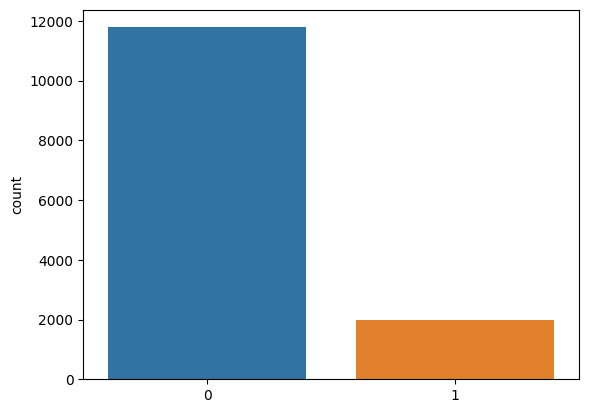

In [62]:
sns.countplot(x=y_train)

<Axes: ylabel='count'>

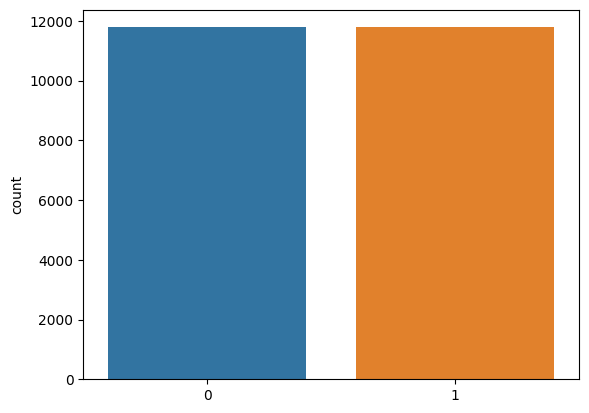

In [63]:
sns.countplot(x=y_sm_train)

Take a look of what we did with resample, now the dataset is balanced and we can probably estimate better with machine learning algorithms.  Also, note the sampled data is higher than the original data.  Let's test with undersample now.

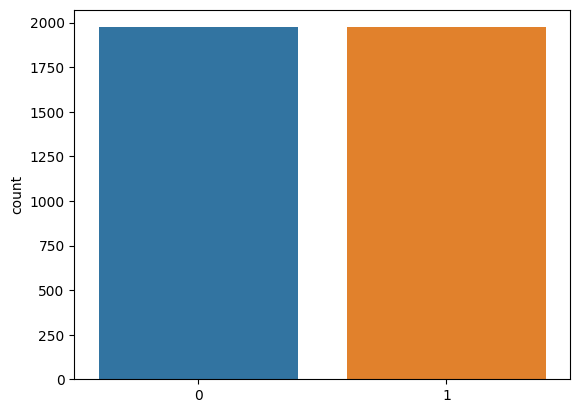

In [64]:
rus = RandomUnderSampler(random_state=42)
X_rus_train, y_rus_train = rus.fit_resample(X_train, y_train) # JUST RESAMPLE THE TRAINING SET!!!
sns.countplot(x=y_rus_train)
plt.show()

Now we got from 12k to near 2k. That is what undersample do, it will try to adjust effectively the minority or majority class to the data and make it balanced.  In our experience, SMOT and RandomOverSampler give me the best results, but that is a part of tests that you could do.

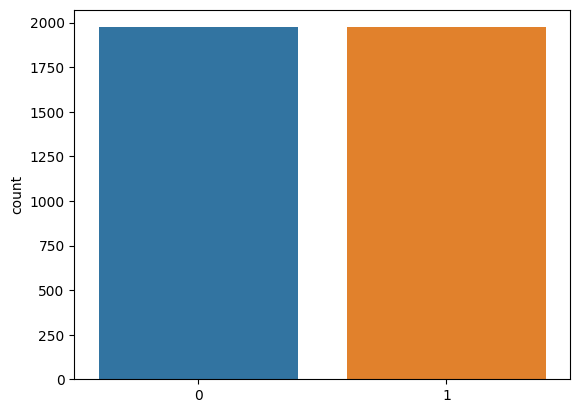

In [65]:
ros = RandomOverSampler(random_state=42)
X_ros_train, y_ros_train = rus.fit_resample(X_train, y_train) # JUST RESAMPLE THE TRAINING SET!!!
sns.countplot(x=y_ros_train)
plt.show()

## 6 - Building Machine Learning Algorithms!

In this part we will build simple machine learning algorithms using scikit-learn.  

<img src="img/classification.png" width="30%" height="30%">

After building the machine learning pipeline, we will do hyperparameter tunning, that is we will list a bunch of parameters and search for the best model in the machine learning algorithm pack.  With this we will ensure we get the best performance of the model using different parameters and measuring the output.

<img src="img/hyperparameter.png" width="30%" height="30%">

### 6.1 - Building a machine learning pipeline and Parameter Grid

Pipelines are very usefull tool, it will be usefull to make packed models. See scikit-learn documentation for more algorithms that you can use for classification if you want.

You could explore hyperparamters of each algorithm if you have instantiated with the function `.get_params`or if you what with double `??`

In [66]:
# we are building a tuple of name, model to pass later to a for loop
models = {'sgd': SGDClassifier(),
          'ridge':RidgeClassifier(),
          'rf': RandomForestClassifier(),
          'gb': GradientBoostingClassifier(),
          'xg': XGBClassifier()
          }

# make the parameter grid to loop
param_grid = {
    'sgd':{'sgdclassifier__alpha':[0.00001, 0.0001, 0.001, 0.01]},
    'ridge':{'ridgeclassifier__alpha':[0.01, 0.05, 1.0, 2.0, 3.0]},
    'rf':{'randomforestclassifier__n_estimators': [50, 100, 200, 300, 500],
          'randomforestclassifier__max_depth': [None, 5, 7, 9]
         },
    'gb':{'gradientboostingclassifier__n_estimators':[50, 100, 200, 300],
          'gradientboostingclassifier__max_depth': [None, 3, 5, 7, 9]
         },
    'xg':{'xgbclassifier__n_estimators':[50, 100, 200, 300],
          'xgbclassifier__max_depth': [None, 3, 5, 7, 9]
         }
}

### 6.2 - Train The Model!

Now we get to the exciting part, you will found that building a machine learning model is just 1 or 2 lines of code, but the previous work is what differentiate a good machine learning engineer to a good one.

In [67]:
# # in the for loop we will make a pipeline for each algorithms
fitted_models = dict()                              # we build a dict to store results objects
for algo, model in models.items():                  # for all models
    print(f'Training model {algo}')                 # 
    pipe = make_pipeline(StandardScaler(), model)   # make a pipeline for each model
    grid = GridSearchCV(estimator=pipe,             # make an hyperparamter search
                        param_grid=param_grid[algo], 
                        n_jobs=-1, cv=10, refit=True)
    grid.fit(X_ros_train, y_ros_train)              # fit the model
    fitted_models[algo] = grid                      # store the model
    print(f'Training for {algo} completed')         #

Training model sgd
Training for sgd completed
Training model ridge
Training for ridge completed
Training model rf
Training for rf completed
Training model gb
Training for gb completed
Training model xg
Training for xg completed


### 6.2 - Make a data transformation for the test set

Normally you will do a transform function to treat the origintal dataset, but we did this step-by-step in previous parts.  So we will not repeat that.

### 6.3 - Evaluate the performance Metrics

Now we will measure the effectivity of all of our models with some metrics like precision, recall, and area under curve.
<img src="img/metrics1.jpg" width="50%" height="50%">  <img src="img/metrics2.png" width="30%" height="30%">

In [68]:
fitted_evals = dict()
for algo, model in fitted_models.items():       # for all models
    print(f'Evaluating Metrics for {algo}')     #           
    y_pred = model.predict(X_test)              # make prediction!
    accuracy = accuracy_score(y_test, y_pred)   # evaluation metrics calculations
    precision = precision_score(y_test, y_pred)
    recall = recall_score(y_test, y_pred)
    f1 = f1_score(y_test, y_pred)
    cm = confusion_matrix(y_test, y_pred)
    auc = roc_auc_score(y_test, y_pred)
    fitted_evals[algo] = {'precision':precision, # store metrics 
                          'recall':recall, 
                          'f1': f1, 
                          'accuracy': 
                          accuracy, 'cm': 
                          cm, 'auc': auc
                         }
    print(f'Evaluation for {algo} completed')    #

Evaluating Metrics for sgd
Evaluation for sgd completed
Evaluating Metrics for ridge
Evaluation for ridge completed
Evaluating Metrics for rf
Evaluation for rf completed
Evaluating Metrics for gb
Evaluation for gb completed
Evaluating Metrics for xg
Evaluation for xg completed


In [69]:
model_evaluations = pd.DataFrame(fitted_evals)
model_evaluations.T.sort_values(by=['precision', 'auc'], ascending=[False, False])

,precision,recall,f1,accuracy,cm,auc
xg,0.63369,0.959514,0.763285,0.914535,"[[2672, 274], [20, 474]]",0.933253
gb,0.622865,0.959514,0.755378,0.910756,"[[2659, 287], [20, 474]]",0.931047
rf,0.582217,0.967611,0.726996,0.89564,"[[2603, 343], [16, 478]]",0.925591
sgd,0.550602,0.925101,0.690332,0.880814,"[[2573, 373], [37, 457]]",0.899244
ridge,0.534722,0.935223,0.680412,0.873837,"[[2544, 402], [32, 462]]",0.899383


Look again on the performance metrics, we need to overcome and in this case improve precision, in some cases you will want a better recall than precision for example in a medical field, where it will predict more people to be detected than non detected, check

 <img src="img/metrics3.png" width="90%" height="90%">

Usually to understand better the model we explore the confusion matrix.

If we see, we have a lot of people predicted as will be churning but in reality is not (274).  Evaluate and interpretate the metrics to get best understanding of the application.  As we told previously, we could make the model to perform worse on some metrics, in this case because is churn the model will be selected with the best precision this time.

In [70]:
best_model = fitted_models['xg'].best_estimator_
best_model

Pipeline(steps=[('standardscaler', StandardScaler()),
                ('xgbclassifier',
                 XGBClassifier(base_score=None, booster=None, callbacks=None,
                               colsample_bylevel=None, colsample_bynode=None,
                               colsample_bytree=None,
                               early_stopping_rounds=None,
                               enable_categorical=False, eval_metric=None,
                               feature_types=None, gamma=None, gpu_id=None,
                               grow_policy=None, importance_type=None,
                               interaction_constraints=None, learning_rate=None,
                               max_bin=None, max_cat_threshold=None,
                               max_cat_to_onehot=None, max_delta_step=None,
                               max_depth=5, max_leaves=None,
                               min_child_weight=None, missing=nan,
                               monotone_constraints=None, n_estimators=50,
                               n_jobs=None, num_parallel_tree=None,
                               predictor=None, random_state=None, ...))])

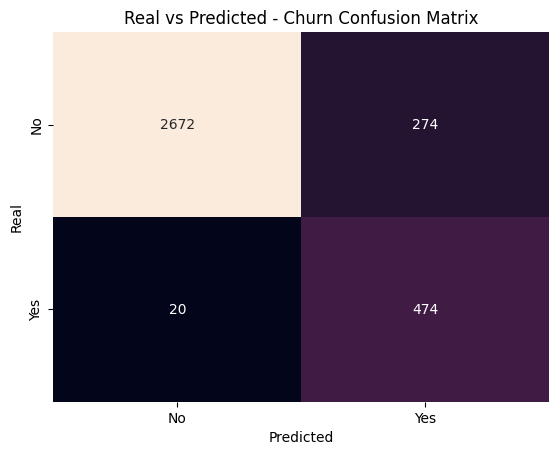

In [71]:
ax = sns.heatmap(model_evaluations.loc['cm', 'xg'], fmt='d', annot=True, cbar=False)
plt.xlabel('Predicted')
plt.ylabel('Real')
ax.set_xticklabels(['No', 'Yes'])
ax.set_yticklabels(['No', 'Yes'])
ax.set_title('Real vs Predicted - Churn Confusion Matrix')
plt.show()

### 6.4 - Making Predictions

We will now make predictions on the test data to see the evaluation one by one, that is a part that sometimes we want to do.  Inspect visually the predictions, so let's start to do som predictions on randomly choice data.

In [72]:
id_rnd = np.random.choice(X_test.index, 20)  # select 20 different random indexes
X_test_rnd = X_test.loc[id_rnd]              # select the random test data                      
y_test_pred_rnd = pd.Series(best_model.predict(X_test_rnd), index=id_rnd) # predict over the random data (tag them to get the same data as index)
y_test_with_id = pd.Series(y_test, index=X_test.index) # tag the ids to y_test
y_test_rnd = y_test_with_id.loc[id_rnd]      # select the same random data with y_test
predictions = pd.DataFrame([y_test_rnd, y_test_pred_rnd], index=['Real', 'Pred']) # construct a dataframe
predictions                                  # view the results

,7451,5939,4706,997,8950,14822,9157,15588,4161,559,14197,6496,12869,10289,15920,6303,12128,1486,8872,6885
Real,1,0,1,0,0,0,0,0,0,0,0,1,0,0,0,0,1,0,0,0
Pred,1,0,1,0,0,0,0,0,0,0,0,1,0,0,0,0,1,0,0,1


## 6 - Save and Serialize the Models and Encoder

OK, selected our `best_model` the next part is to serialize the model to make production ready applications, that is part of the machine learning modeling.  Our goal after approved the model is to make them available to our clients (internal or external) to consume the application and then make use of them and give feedback to us.

### 6.1 - Serialize the model 

In [73]:
MODEL_DIR = os.path.join('models', 'experiment_1') # construct a string path
if not os.path.exists(MODEL_DIR):             # if the path to save do not exists
    os.makedirs(MODEL_DIR)                    # create the complete path, for example, <current_directory>/models/experiment_1

In [74]:
for algo, model in fitted_models.items():     # for each algorithm
    FPATH = os.path.join(MODEL_DIR, f'{algo}.joblib') # create the algorithm in the file path of experimets
    with open(FPATH, 'wb') as f:              # Open a file to be written
        joblib.dump(model, f)                 # serialize the model
    print(f'Saved Model {algo}')              #

Saved Model sgd
Saved Model ridge
Saved Model rf
Saved Model gb
Saved Model xg


In [75]:
os.listdir(MODEL_DIR) # inspecting the folder to see if the models are saved

['gb.joblib',
 'ohe.joblib',
 'rf.joblib',
 'ridge.joblib',
 'sgd.joblib',
 'xg.joblib']

In [76]:
joblib.load(os.path.join(MODEL_DIR, 'gb.joblib')) # testing if we can load a model

GridSearchCV(cv=10,
             estimator=Pipeline(steps=[('standardscaler', StandardScaler()),
                                       ('gradientboostingclassifier',
                                        GradientBoostingClassifier())]),
             n_jobs=-1,
             param_grid={'gradientboostingclassifier__max_depth': [None, 3, 5,
                                                                   7, 9],
                         'gradientboostingclassifier__n_estimators': [50, 100,
                                                                      200,
                                                                      300]})

### 6 -  Save the encoder

We need to save the encoder data to transform our original data later, remember the encoder was not inside the pipeline so we need the transformations he gives to the data.

In [77]:
ENCODER_PATH = os.path.join(MODEL_DIR, 'ohe.joblib') # path to save the encoder
with open(ENCODER_PATH, 'wb') as f:                  # open a file to save
    joblib.dump(ohe, f)                              # serialize the one hot encoder
print('Saved OneHotEncoder')                         # save the encoder

Saved OneHotEncoder


In [78]:
joblib.load(ENCODER_PATH)     # testing if we can load the encoder

OneHotEncoder(handle_unknown='ignore')

### 7 - Create a Model Schema in JSON Format

We need to create a schema (in JSON format), remember the original data is not the same colum name, column format and order, so we need to create a schema to transform our dataset to feed into our model.  This is necessary if we are building a deployment application to serve well and warrant good results.

In [244]:
def extract_col_values(col, df):               # create a function to make the columns values extracted
    dtype = df[col].dtype                      # get the data type
    values = df[col]                           # column values
    if dtype == 'O':                           # if type is object
        return list(values.unique())           # return unique values
    if dtype == 'int64': # if type is number
        return (int(values.min()), int(values.max()))  # return min and max in tuple
    if dtype == 'float64': # if type is number
        return (float(values.min()), float(values.max()))  # return min and max in tuple    
    
def extract_col_dtype(col, df):                # make function to extract data types
    return df[col].dtype                       # 

In [245]:
extract_col_values('tenure', df_schema)        # test the extractions

(1, 242)

In [246]:
extract_col_dtype('tenure', df_schema)

dtype('int64')

In [248]:
# we are creating a dictionary looping for each column of the dataframe and then storing ina column info dictionary
col_info = {
    col: {'dtype' : str(extract_col_dtype(col, df_schema)), 'values': extract_col_values(col, df_schema)} 
    for col in df_schema.columns
}
col_info

{'id': {'dtype': 'int64', 'values': (0, 17242)},
 'state_code': {'dtype': 'object',
  'values': ['HI',
   'MI',
   'NH',
   'MN',
   'TX',
   'WY',
   'IN',
   'IL',
   'TN',
   'MA',
   'DC',
   'NV',
   'PA',
   'AK',
   'NM',
   'WI',
   'ND',
   'NJ',
   'AR',
   'NE',
   'NY',
   'OK',
   'SD',
   'KY',
   'ID',
   'VT',
   'IA',
   'MT',
   'AL',
   'MS',
   'ME',
   'WV',
   'RI',
   'VA',
   'OH',
   'SC',
   'MD',
   'CO',
   'AZ',
   'NC',
   'CT',
   'MO',
   'UT',
   'DE',
   'WA',
   'KS',
   'CA',
   'FL',
   'LA',
   'GA',
   'OR']},
 'tenure': {'dtype': 'int64', 'values': (1, 242)},
 'contract_length': {'dtype': 'float64', 'values': (8.0, 24.0)},
 'promotions_offered': {'dtype': 'object', 'values': ['Yes', 'No', 'NO', nan]},
 'remaining_term': {'dtype': 'float64', 'values': (1.0, 24.0)},
 'last_nps_rating': {'dtype': 'float64', 'values': (1.0, 10.0)},
 'area_code': {'dtype': 'object',
  'values': ['area_code_510', 'area_code_408', 'area_code_415', nan]},
 'international

OK, above we have an schema of the columns that we have. let's now get the schema list of the transformed columns and create the full schema.

In [249]:
# list the columns after the transformation
transformed_cols = list(X_train.columns)
transformed_cols

['tenure',
 'contract_length',
 'remaining_term',
 'last_nps_rating',
 'number_vmail_messages',
 'total_day_calls',
 'total_eve_calls',
 'total_night_calls',
 'total_intl_calls',
 'number_customer_service_calls',
 'log_number_customer_service_calls',
 'total_eve_minutes_missing',
 'day_ratio',
 'eve_ratio',
 'night_ratio',
 'intl_ratio',
 'unhappy_customers',
 'state_code_AK',
 'state_code_AL',
 'state_code_AR',
 'state_code_AZ',
 'state_code_CA',
 'state_code_CO',
 'state_code_CT',
 'state_code_DC',
 'state_code_DE',
 'state_code_FL',
 'state_code_GA',
 'state_code_HI',
 'state_code_IA',
 'state_code_ID',
 'state_code_IL',
 'state_code_IN',
 'state_code_KS',
 'state_code_KY',
 'state_code_LA',
 'state_code_MA',
 'state_code_MD',
 'state_code_ME',
 'state_code_MI',
 'state_code_MN',
 'state_code_MO',
 'state_code_MS',
 'state_code_MT',
 'state_code_NC',
 'state_code_ND',
 'state_code_NE',
 'state_code_NH',
 'state_code_NJ',
 'state_code_NM',
 'state_code_NV',
 'state_code_NY',
 'state_

In [250]:
# construct the full schema
schema = {'col_info': col_info, 'transformed_columns': transformed_cols}
schema

{'col_info': {'id': {'dtype': 'int64', 'values': (0, 17242)},
  'state_code': {'dtype': 'object',
   'values': ['HI',
    'MI',
    'NH',
    'MN',
    'TX',
    'WY',
    'IN',
    'IL',
    'TN',
    'MA',
    'DC',
    'NV',
    'PA',
    'AK',
    'NM',
    'WI',
    'ND',
    'NJ',
    'AR',
    'NE',
    'NY',
    'OK',
    'SD',
    'KY',
    'ID',
    'VT',
    'IA',
    'MT',
    'AL',
    'MS',
    'ME',
    'WV',
    'RI',
    'VA',
    'OH',
    'SC',
    'MD',
    'CO',
    'AZ',
    'NC',
    'CT',
    'MO',
    'UT',
    'DE',
    'WA',
    'KS',
    'CA',
    'FL',
    'LA',
    'GA',
    'OR']},
  'tenure': {'dtype': 'int64', 'values': (1, 242)},
  'contract_length': {'dtype': 'float64', 'values': (8.0, 24.0)},
  'promotions_offered': {'dtype': 'object',
   'values': ['Yes', 'No', 'NO', nan]},
  'remaining_term': {'dtype': 'float64', 'values': (1.0, 24.0)},
  'last_nps_rating': {'dtype': 'float64', 'values': (1.0, 10.0)},
  'area_code': {'dtype': 'object',
   'values':

Great!, now lets use the json library to save the schema to the folder

In [251]:
if not os.path.exists('app'):             # if the path to save do not exists make the directory
    os.makedirs('app') 
with open(os.path.join('app', 'schema.json'), 'w') as f: # save the schema
    json.dump(schema, f, indent=4)

Finally we need to do some manual cleaning on the schema
- Remove the nans
- Remove NO from the promotions_offered column in the schema
- Remember to remove the last , of the json data when you remove the nans and NO
- Save the schema

In [252]:
with open(os.path.join('app', 'schema.json'), 'r') as f: # reload the schema (testing it)
    schema_ = json.load(f)
schema_

{'col_info': {'id': {'dtype': 'int64', 'values': [0, 17242]},
  'state_code': {'dtype': 'object',
   'values': ['HI',
    'MI',
    'NH',
    'MN',
    'TX',
    'WY',
    'IN',
    'IL',
    'TN',
    'MA',
    'DC',
    'NV',
    'PA',
    'AK',
    'NM',
    'WI',
    'ND',
    'NJ',
    'AR',
    'NE',
    'NY',
    'OK',
    'SD',
    'KY',
    'ID',
    'VT',
    'IA',
    'MT',
    'AL',
    'MS',
    'ME',
    'WV',
    'RI',
    'VA',
    'OH',
    'SC',
    'MD',
    'CO',
    'AZ',
    'NC',
    'CT',
    'MO',
    'UT',
    'DE',
    'WA',
    'KS',
    'CA',
    'FL',
    'LA',
    'GA',
    'OR']},
  'tenure': {'dtype': 'int64', 'values': [1, 242]},
  'contract_length': {'dtype': 'float64', 'values': [8.0, 24.0]},
  'promotions_offered': {'dtype': 'object',
   'values': ['Yes', 'No', 'NO', nan]},
  'remaining_term': {'dtype': 'float64', 'values': [1.0, 24.0]},
  'last_nps_rating': {'dtype': 'float64', 'values': [1.0, 10.0]},
  'area_code': {'dtype': 'object',
   'values':

### 7 - Test the application flow

After creating the schema, we need to get the application flow to work, let's test all the functions and then get the workflow of opening and reading files ready to work before integrating.

#### 7.1 - Test loading objects

In [253]:
# loading the model
with open(os.path.join(MODEL_DIR, 'xg.joblib'), 'rb') as f:
    model = joblib.load(f)
model

GridSearchCV(cv=10,
             estimator=Pipeline(steps=[('standardscaler', StandardScaler()),
                                       ('xgbclassifier',
                                        XGBClassifier(base_score=None,
                                                      booster=None,
                                                      callbacks=None,
                                                      colsample_bylevel=None,
                                                      colsample_bynode=None,
                                                      colsample_bytree=None,
                                                      early_stopping_rounds=None,
                                                      enable_categorical=False,
                                                      eval_metric=None,
                                                      feature_types=None,
                                                      gamma=None, gpu_id=None,
                                                      grow_policy=None...
                                                      max_cat_threshold=None,
                                                      max_cat_to_onehot=None,
                                                      max_delta_step=None,
                                                      max_depth=None,
                                                      max_leaves=None,
                                                      min_child_weight=None,
                                                      missing=nan,
                                                      monotone_constraints=None,
                                                      n_estimators=100,
                                                      n_jobs=None,
                                                      num_parallel_tree=None,
                                                      predictor=None,
                                                      random_state=None, ...))]),
             n_jobs=-1,
             param_grid={'xgbclassifier__max_depth': [None, 3, 5, 7, 9],
                         'xgbclassifier__n_estimators': [50, 100, 200, 300]})

In [254]:
with open(os.path.join(MODEL_DIR, 'ohe.joblib'), 'rb') as f:
    ohe = joblib.load(f)
ohe

OneHotEncoder(handle_unknown='ignore')

In [255]:
# load the schema
with open(os.path.join('app', 'schema.json'), 'r') as f: # reload the schema (testing it)
    schema = json.load(f)
schema

{'col_info': {'id': {'dtype': 'int64', 'values': [0, 17242]},
  'state_code': {'dtype': 'object',
   'values': ['HI',
    'MI',
    'NH',
    'MN',
    'TX',
    'WY',
    'IN',
    'IL',
    'TN',
    'MA',
    'DC',
    'NV',
    'PA',
    'AK',
    'NM',
    'WI',
    'ND',
    'NJ',
    'AR',
    'NE',
    'NY',
    'OK',
    'SD',
    'KY',
    'ID',
    'VT',
    'IA',
    'MT',
    'AL',
    'MS',
    'ME',
    'WV',
    'RI',
    'VA',
    'OH',
    'SC',
    'MD',
    'CO',
    'AZ',
    'NC',
    'CT',
    'MO',
    'UT',
    'DE',
    'WA',
    'KS',
    'CA',
    'FL',
    'LA',
    'GA',
    'OR']},
  'tenure': {'dtype': 'int64', 'values': [1, 242]},
  'contract_length': {'dtype': 'float64', 'values': [8.0, 24.0]},
  'promotions_offered': {'dtype': 'object',
   'values': ['Yes', 'No', 'NO', nan]},
  'remaining_term': {'dtype': 'float64', 'values': [1.0, 24.0]},
  'last_nps_rating': {'dtype': 'float64', 'values': [1.0, 10.0]},
  'area_code': {'dtype': 'object',
   'values':

#### 7.2 - Test loading and making a prediction

Now lets read the first row, just to have one sample and get prepared for the prediction (also make 1 prediction)

In [256]:
payload_dict = df_schema.iloc[9].to_dict()             # get an example
del(payload_dict['id'])                                # delete id
del(payload_dict['churn'])                             # delete target
with open(os.path.join('app', 'test.json'), 'w') as f: # save in the app folder
    json.dump(payload_dict, f, indent=4)               # indented to pretty print

In [257]:
column_order_in = list(schema['col_info'].keys())[1:-1] # extract column order
column_order_out = list(schema['transformed_columns'])  # get the output order

In [258]:
with open(os.path.join('app', 'test.json'), 'r') as f:  # test loading the payload
    payload = json.load(f)
payload

{'state_code': 'TN',
 'tenure': 226,
 'contract_length': 21.0,
 'promotions_offered': 'No',
 'remaining_term': 23.0,
 'last_nps_rating': 7.0,
 'area_code': 'area_code_408',
 'international_plan': 'no',
 'voice_mail_plan': 'yes',
 'number_vmail_messages': 36,
 'total_day_minutes': 227.2208757,
 'total_day_calls': 88,
 'total_day_charge': 38.01509427,
 'total_eve_minutes': 149.7237666,
 'total_eve_calls': 73,
 'total_eve_charge': 12.57766004,
 'total_night_minutes': 193.6780632,
 'total_night_calls': 77,
 'total_night_charge': 8.496320298,
 'total_intl_minutes': 4.129411733,
 'total_intl_calls': 5,
 'total_intl_charge': 1.164346253,
 'number_customer_service_calls': 4}

OK, now with the payload loaded, we will transform to a datafrmae to store the positions.

In [259]:
payload_df = pd.DataFrame(data=payload, columns=column_order_in, index=[0])
payload_df

,state_code,tenure,contract_length,promotions_offered,remaining_term,last_nps_rating,area_code,international_plan,voice_mail_plan,number_vmail_messages,...,total_eve_minutes,total_eve_calls,total_eve_charge,total_night_minutes,total_night_calls,total_night_charge,total_intl_minutes,total_intl_calls,total_intl_charge,number_customer_service_calls
0,TN,226,21.0,No,23.0,7.0,area_code_408,no,yes,36,...,149.723767,73,12.57766,193.678063,77,8.49632,4.129412,5,1.164346,4


Now let's validate the dtype for ensuring the data in the same format

In [260]:
for col, col_properties in schema['col_info'].items():  # get the col info
    if col == 'id':                                     # bypass if id is present
        continue
    if col == 'churn':                                  # bypass if churn is present
        continue
    dtype = col_properties['dtype']                     # get the data type
    payload_df[col] = payload_df[col].astype(dtype)     # transform to this type

In [261]:
payload_df

,state_code,tenure,contract_length,promotions_offered,remaining_term,last_nps_rating,area_code,international_plan,voice_mail_plan,number_vmail_messages,...,total_eve_minutes,total_eve_calls,total_eve_charge,total_night_minutes,total_night_calls,total_night_charge,total_intl_minutes,total_intl_calls,total_intl_charge,number_customer_service_calls
0,TN,226,21.0,No,23.0,7.0,area_code_408,no,yes,36,...,149.723767,73,12.57766,193.678063,77,8.49632,4.129412,5,1.164346,4


OK, now let's do a transformation function to the data before making the predictions

In [297]:
# just storing all the others transformations to keep the prediction
def transform_data(payload, col_order_out, mean_eve_mins=200.4387, ohe=OneHotEncoder()):
    payload_ohe = ohe.transform(payload[ohe.feature_names_in_]).toarray()
    payload_ohe = pd.DataFrame(payload_ohe, columns=ohe.get_feature_names_out())
    payload_concat = pd.concat([payload, payload_ohe], axis=1)
    payload_concat['log_number_customer_service_calls'] = np.log1p(payload_concat['number_customer_service_calls'])
    payload_concat['day_ratio'] = payload_concat['total_day_charge'] / payload_concat['total_day_minutes']
    payload_concat['eve_ratio'] = payload_concat['total_eve_charge'] / payload_concat['total_eve_minutes']
    payload_concat['night_ratio'] = payload_concat['total_night_charge'] / payload_concat['total_night_minutes']
    payload_concat['intl_ratio'] = payload_concat['total_intl_charge'] / payload_concat['total_intl_minutes']
    payload_concat['unhappy_customers'] = ((payload_concat['remaining_term'] < 5) & 
                                           (payload_concat['last_nps_rating'] <= 7) & 
                                           (payload_concat.promotions_offered == 'No')).astype(bool)
    payload_concat['total_eve_minutes_missing'] = payload_concat.total_eve_minutes.isna().astype(bool)
    payload_concat.total_eve_minutes.fillna(200.4387, inplace=True) 
    
    payload_transformed = payload_concat[col_order_out]
    return payload_transformed

In [299]:
res_sample = transform_data(payload_df, column_order_out, mean_eve_min, ohe)
res_sample

,tenure,contract_length,remaining_term,last_nps_rating,number_vmail_messages,total_day_calls,total_eve_calls,total_night_calls,total_intl_calls,number_customer_service_calls,...,promotions_offered_Yes,area_code_area_code_408,area_code_area_code_415,area_code_area_code_510,area_code_missing,international_plan_no,international_plan_yes,voice_mail_plan_missing,voice_mail_plan_no,voice_mail_plan_yes
0,226,21.0,23.0,7.0,36,88,73,77,5,4,...,0.0,1.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,1.0


In [300]:
model.predict(res_sample)

array([0])

Phew, that was a lot of work, but it was necessary to make the machine learning model.  Next we will be building the streamlit app that will make predictions over the built model.

<img src="img/welldone.png" width="20%" height="20%">